<a href="https://colab.research.google.com/github/mukeshsharma1981/ML-Projects/blob/main/ML_Logistic_Regression.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [43]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, Lasso, RidgeCV, LassoCV, ElasticNet, ElasticNetCV, LogisticRegression
from sklearn.model_selection import train_test_split as tts
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
import pickle 

In [12]:
df = pd.read_csv('/content/diabetes.csv')

In [13]:
df.head(5)

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [4]:
## To install pandas profileing
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip


In [5]:
profile=ProfileReport(df)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
df['BMI']=df['BMI'].replace(0, df['BMI'].mean()) 

In [14]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [15]:
df_col = ['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI']

In [16]:
for i in df_col:
  df[i]=df[i].replace(0, df[i].mean()) 

In [17]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

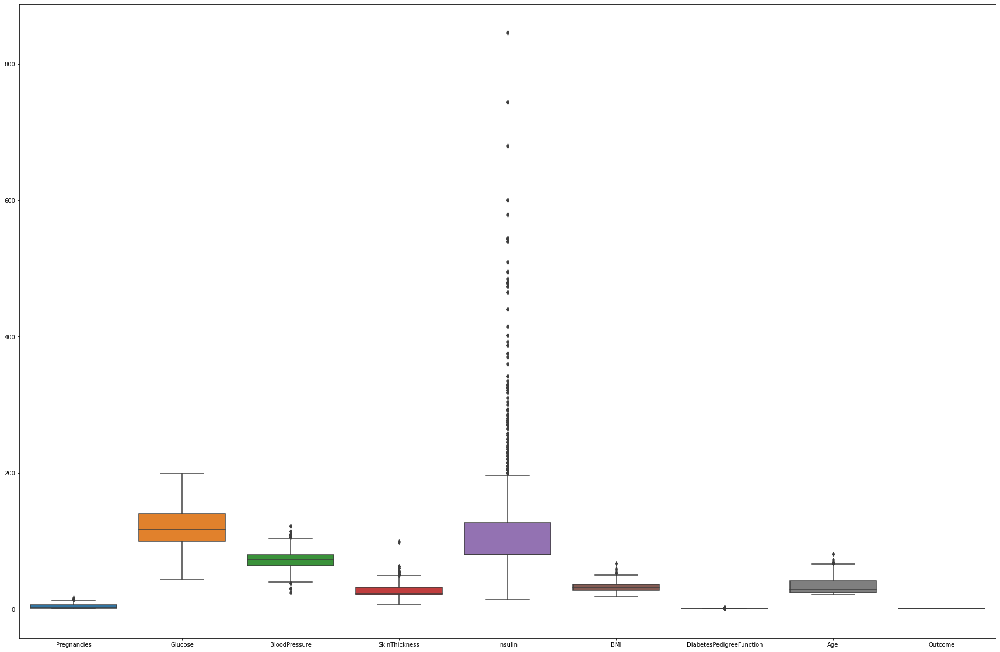

In [22]:
fig, ax = plt.subplots(figsize=(30,20))
sns.boxplot(data=df, ax=ax)

In [26]:
## Outlier through filters
q = df['Pregnancies'].quantile(.98)
df_new = df[df['Pregnancies'] < q]

q = df['BMI'].quantile(.99)
df_new = df[df['BMI'] < q]

q = df['SkinThickness'].quantile(.99)
df_new = df[df['SkinThickness'] < q]

q = df['Insulin'].quantile(.95)
df_new = df[df['Insulin'] < q]

q = df['DiabetesPedigreeFunction'].quantile(.95)
df_new = df[df['DiabetesPedigreeFunction'] < q]


In [24]:
## Outlier through function
def outlier_removal(self, data):
  def outlier_limits(col):
    Q3, Q1 = np.nanpercentile(col[75, 25])
    IQR = Q3-Q1
    UL=Q3+1.5*IQR
    LL=Q1-1.5*IQR
    return UL, LL

  for column in data.columns:
    if data[column].dtype == 'int64':
      UL,LL = outlier_limits(data[column])
      data[column] = np.where((data[column] > UL) | (data[column] < LL), np.nan, data[column])
  return data




In [28]:
scalar = StandardScaler()
ProfileReport(pd.DataFrame(scalar.fit_transform(df_new)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [55]:
X = df_new.drop('Outcome', axis=1)
y = df_new.Outcome
print(X.shape)
print(y.shape)


(729, 8)
(729,)


In [64]:
scaler=StandardScaler()
X_scaled= scaler.fit_transform(X)


In [58]:
def vif_score(x):
  scaler=StandardScaler()
  arr = scaler.fit_transform(x)
  return pd.DataFrame([[x.columns[i], variance_inflation_factor(arr,i)] for i in range(arr.shape[1])], columns=['features', 'vif_scores'])


In [59]:
vif_score(X)

,features,vif_scores
0,Pregnancies,1.434100
1,Glucose,1.331684
2,BloodPressure,1.241305
3,SkinThickness,1.408877
4,Insulin,1.263292
5,BMI,1.511224
6,DiabetesPedigreeFunction,1.035104
7,Age,1.616797


In [65]:
X_train, X_test, y_train, y_test = tts(X_scaled, y, test_size=.20, random_state=1)

In [67]:
logr = LogisticRegression(verbose=1)
logr.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s finished


LogisticRegression(verbose=1)

In [69]:
logr.predict_proba([X_test[0]])

array([[0.87128958, 0.12871042]])

In [70]:
logr.predict_log_proba([X_test[0]])

array([[-0.13778089, -2.0501902 ]])

In [74]:
y_pred = logr.predict(X_test)

In [75]:
confusion_matrix(y_test, y_pred)

array([[90,  9],
       [23, 24]])

In [76]:
def model_eval(y_true, y_pred):
  tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
  accuracy = (tp+tn) / (tn+fp+fn+tp)
  precision = tp / (tp+fp)
  recall = tp / (tp + fn)
  specificity = tn/(fp+tn)
  result={"Accuracy":accuracy, "Precision":precision, "Recall":recall, "Specificity":specificity}
  return result

model_eval(y_test, y_pred)  

{'Accuracy': 0.7808219178082192,
 'Precision': 0.7272727272727273,
 'Recall': 0.5106382978723404,
 'Specificity': 0.9090909090909091}

In [79]:
auc = roc_auc_score(y_test, y_pred)

In [82]:
fpr, tpr , thresholds = roc_curve(y_test, y_pred)

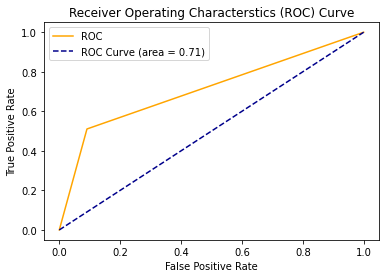

In [83]:
plt.plot(fpr, tpr, color='orange', label='ROC')
plt.plot([0,1], [0,1], color='darkblue', linestyle='--', label='ROC Curve (area = %0.2f)' % auc)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title('Receiver Operating Characterstics (ROC) Curve')
plt.legend()
plt.show()
